# Generation of aperture files including the fid measurements

In [1]:
import pandas as pd
from pandas import HDFStore
import numpy as np
import glob

In [77]:
# ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# Function to read aperture output from MADX as DataFrames
# ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
def readtfsaper(tfsfile):
    df = pd.read_csv(tfsfile,skiprows=range(30),nrows=2,delim_whitespace=True)
    df = df[df['NAME']!='%s']
    colsdf = list(df.columns[1:])
    df = pd.read_csv(tfsfile,skiprows=range(32),delim_whitespace=True,names=colsdf,index_col=False)
    return df

# ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# Reading the MADX files
# ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
aperdfsb2 = readtfsaper('/afs/cern.ch/work/t/tomerten/sixtrack/LHCB2n1.tfs')
aperdfsb1 = readtfsaper('/afs/cern.ch/work/t/tomerten/sixtrack/LHCB1.n1.tfs')

# ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# Generating file for Beam 1
# ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
trueaperdfb1 = pd.DataFrame(columns=['S','NAME','APERX','APERY'])

flist=glob.glob('/afs/cern.ch/user/t/tomerten/aperture/b1/newelement*')

notlistb1 =[] # keeps track of skipped elements

for fn in flist:
    name   = pd.read_csv(fn,nrows=1,header=None).values[0][0]
    dfelem = pd.read_csv(fn,skiprows=1,header=None,names=['S','DX','DY'],delim_whitespace=True)
    
    if len(aperdfsb1[aperdfsb1['NAME']==name]) !=0:
        elementsstart = aperdfsb1[aperdfsb1['NAME']==name].head(1)['S'].values[0]
        dfelem['S'] = dfelem['S'] + elementsstart
        dftemp = pd.DataFrame(columns=['S','NAME','APERX','APERY'])
        dftemp['S'] = dfelem['S']
        dftemp['NAME'] = [name] * len(dftemp)
        dftemp['APERX'] =  (aperdfsb1[aperdfsb1['NAME']==name].head(1)['APER_1'].values[0]+dfelem['DX'])*1000000.
        dftemp['APERY'] =  (aperdfsb1[aperdfsb1['NAME']==name].head(1)['APER_3'].values[0]+dfelem['DY'])*1000000.
        trueaperdfb1=trueaperdfb1.append(dftemp,ignore_index=True)
    else:    
        notlistb1.append(name)
        
trueaperdfb1       = trueaperdfb1.sort_values(by='S',ascending=[1])
tdf                = aperdfsb1[['S','NAME','APER_1','APER_3']]
tdf.columns        = ['S','NAME','APERX','APERY']
tdf.loc[:,'APERX'] = tdf['APERX']*1000000
tdf.loc[:,'APERY'] = tdf['APERY']*1000000

leftlistb1       = set(trueaperdfb1['NAME'])
b1mask           = -tdf.NAME.isin(leftlistb1)
b1dfsel1         = tdf[b1mask]
b1mask2          = b1dfsel1.APERX>0.0
b1dfsel2         = b1dfsel1[b1mask2]
dfb1             = pd.concat([trueaperdfb1,b1dfsel2]).sort_values(by='S')

# trueaperdfb1.to_csv('TrueapertureB1.csv',index=False)

# ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# Generating file for Beam 2
# ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
trueaperdfb2 = pd.DataFrame(columns=['S','NAME','APERX','APERY'])

flist=glob.glob('/afs/cern.ch/user/t/tomerten/aperture/newelement*')

notlistb2 =[]
for fn in flist:
    name   = pd.read_csv(fn,nrows=1,header=None).values[0][0]
    dfelem = pd.read_csv(fn,skiprows=1,header=None,names=['S','DX','DY'],delim_whitespace=True)
    
    if len(aperdfsb2[aperdfsb2['NAME']==name]) !=0:
        elementsstart = aperdfsb2[aperdfsb2['NAME']==name].head(1)['S'].values[0]
        dfelem['S'] = dfelem['S'] + elementsstart
        dftemp = pd.DataFrame(columns=['S','NAME','APERX','APERY'])
        dftemp['S'] = dfelem['S']
        dftemp['NAME'] = [name] * len(dftemp)
        dftemp['APERX'] =  (aperdfsb2[aperdfsb2['NAME']==name].head(1)['APER_1'].values[0]+dfelem['DX'])*1000000.
        dftemp['APERY'] =  (aperdfsb2[aperdfsb2['NAME']==name].head(1)['APER_3'].values[0]+dfelem['DY'])*1000000.
        trueaperdfb2=trueaperdfb2.append(dftemp,ignore_index=True)
    else:    
        notlistb2.append(name)
        
trueaperdfb2 =trueaperdfb2.sort_values(by='S',ascending=[1])

tdfb2              = aperdfsb2[['S','NAME','APER_1','APER_3']]
tdfb2.columns      = ['S','NAME','APERX','APERY']
tdfb2.loc[:,'APERX'] = tdfb2['APERX']*1000000
tdfb2.loc[:,'APERY'] = tdfb2['APERY']*1000000

leftlistb2       = set(trueaperdfb2['NAME'])
b2mask           = -tdfb2.NAME.isin(leftlistb2)
b2dfsel1         = tdfb2[b2mask]
b2mask2          = b2dfsel1.APERX>0.0
b2dfsel2         = b2dfsel1[b2mask2]
dfb2             = pd.concat([trueaperdfb2,b2dfsel2]).sort_values(by='S')

# trueaperdfb2.to_csv('TrueapertureB2.csv',index=False)

# ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# Opening HDF5 file to store all the data
# ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
hdf = HDFStore('Aperture.h5')
hdf.put('/MADXB1',aperdfsb1,format='t')
hdf.put('/MADXB2',aperdfsb2,format='t')
hdf.put('/aperb1',dfb1,format='t')
hdf.put('/aperb2',dfb2,format='t')
hdf.close()

In [142]:
# adding extra column to make plotting on both sides of ip1 easier
sip1 = aperb1[aperb1['NAME']=='IP1.L1']['S'].values
aperb1['S2']= aperb1['S']-sip1

sip12 = aperb2[aperb2['NAME']=='IP1.L1']['S'].values
aperb2['S2']= aperb2['S']-sip12
aperb2.head()

,S,NAME,APERX,APERY,S2
1,0.00000,ATLASPIPE1.R1,29000.0,29000.0,-26658.88320
2,0.00000,IP1,29000.0,29000.0,-26658.88320
4,0.36967,ATLASPIPE2.R1,29000.0,29000.0,-26658.51353
6,0.73933,ATLASPIPE3.R1,29000.0,29000.0,-26658.14387
8,1.10900,ATLASPIPE4.R1,29000.0,29000.0,-26657.77420


In [143]:
hdf = HDFStore('Aperture.h5')
hdf.put('/MADXB1',aperdfsb1,format='t')
hdf.put('/MADXB2',aperdfsb2,format='t')
hdf.put('/aperb1',aperb1,format='t')
hdf.put('/aperb2',aperb2,format='t')
hdf.close()

# Checking if the data is stored

In [137]:
hdf = HDFStore('Aperture.h5')
print hdf.keys()
hdf.close()

['/MADXB1', '/MADXB2', '/aperb1', '/aperb2']


# Plotting 

In [144]:
hdf = HDFStore('Aperture.h5')
aperb1 = hdf['/aperb1']
aperb2 = hdf['/aperb2']
hdf.close()

In [145]:
aperb2.columns

Index([u'S', u'NAME', u'APERX', u'APERY', u'S2'], dtype='object')

## Simple plots 2D

In [79]:
from matplotlib import pyplot as plt

[ 26658.8832]


<IPython.core.display.Javascript object>


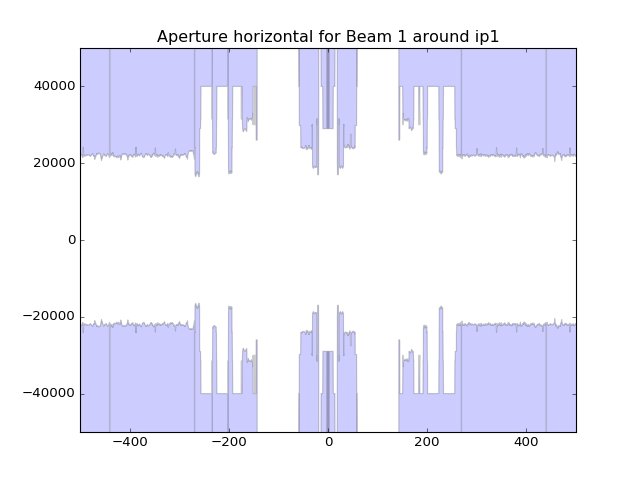

In [81]:
from matplotlib import pyplot as plt
%matplotlib notebook
sip = aperb1[aperb1['NAME']=='IP1.L1']['S'].values
print sip
# ax = plt.plot(aperb1['S'],aperb1['APERX'])
dftemp =aperb1.copy()
dftemp['S']= dftemp['S']-sip
# plt.plot(dftemp['S'],dftemp['APERX'])

plt.fill_between(aperb1['S'],aperb1['APERX'],5000000,alpha=0.2)
plt.fill_between(dftemp['S'],dftemp['APERX'],5000000,alpha=0.2)

plt.fill_between(aperb1['S'],-aperb1['APERX'],-5000000,alpha=0.2)
plt.fill_between(dftemp['S'],-dftemp['APERX'],-5000000,alpha=0.2)
plt.title('Aperture horizontal for Beam 1 around ip1')
plt.xlim(-500,500)
plt.ylim(-50000,50000)
plt.show()

## Interactive plots

### Importing plotting tools

In [82]:
import PlotLyPlottingMod as pltly
import plotly.graph_objs as go

### Setting up layout

In [99]:
lay = pltly.layouttemplate(titlein='Aperture Plot IP1',widthin=1000,heightin=600)
print lay

{'autosize': False, 'title': 'Aperture Plot IP1', 'yaxis': {'tickfont': {'color': 'black', 'family': 'Arial, sans-serif', 'size': 12}, 'showticklabels': True, 'tickwidth': 0.5, 'title': '', 'tick0': 0, 'zerolinewidth': 2, 'ticklen': 10, 'gridwidth': 2, 'dtick': 100, 'range': [-1600, 1600], 'titlefont': {'color': 'black', 'family': 'Arial, sans-serif', 'size': 16}, 'ticks': 'outside', 'tickangle': 0, 'zeroline': True, 'tickcolor': '#000', 'autotick': False, 'linewidth': 4}, 'height': 600, 'shapes': [], 'width': 1000, 'titlefont': {'color': 'black', 'family': 'Arial, sans-serif', 'size': 16}, 'xaxis': {'tickfont': {'color': 'black', 'family': 'Arial, sans-serif', 'size': 12}, 'showticklabels': True, 'tickwidth': 0.5, 'title': '', 'tick0': 0, 'zerolinewidth': 2, 'ticklen': 10, 'gridwidth': 2, 'dtick': 100, 'range': [-1600, 1600], 'titlefont': {'color': 'black', 'family': 'Arial, sans-serif', 'size': 16}, 'ticks': 'outside', 'tickangle': 0, 'zeroline': True, 'tickcolor': '#000', 'autotick'

In [102]:
lay['yaxis']['range']=[-50000,50000]
lay['yaxis']['dtick']=5000

### Plotting aperture around ip1 with plotly

In [158]:
dataly = []
sip1 = aperb2[aperb2['NAME']=='IP1.L1']['S'].values
trace = pltly.tracelist(aperb1['S'],aperb1['APERX'],setmode='lines',hovertext=aperb1['NAME'])
trace['line']={'color':'rgba(50,50,50,0.2)'}
trace['showlegend']=False
dataly.append(trace)
trace = go.Scatter(
                x =  aperb1['S'],
                y = [60000.]*len(aperb1),
                fill = 'tonexty',
                mode = 'lines',
                #name = 'Aperture',
                hoverinfo = 'none',
                fillcolor = 'rgba(50,50,50,0.2)',
                showlegend=False
            )
dataly.append(trace)
trace = pltly.tracelist(aperb1['S'],-aperb1['APERX'],setmode='lines',hovertext=aperb1['NAME'])
trace['line']={'color':'rgba(50,50,50,0.2)'}
trace['showlegend']=False
dataly.append(trace)
trace = go.Scatter(
                x =  aperb1['S'],
                y = [-60000.]*len(aperb1),
                fill = 'tonexty',
                mode = 'lines',
                #name = 'Aperture',
                hoverinfo = 'none',
                fillcolor = 'rgba(50,50,50,0.2)',
                showlegend=False
            )
dataly.append(trace)
trace = pltly.tracelist(aperb2['S2'],aperb2['APERX'],setmode='lines',hovertext=aperb1['NAME'])
trace['line']={'color':'rgba(50,50,50,0.2)'}
trace['showlegend']=False
dataly.append(trace)
trace = go.Scatter(
                x =  aperb2['S2'],
                y = [60000.]*len(aperb2),
                fill = 'tonexty',
                mode = 'lines',
                #name = 'Aperture',
                hoverinfo = 'none',
                fillcolor = 'rgba(50,50,50,0.2)',
                showlegend=False
            )
dataly.append(trace)
trace = pltly.tracelist(aperb2['S2'],-aperb2['APERX'],setmode='lines',hovertext=aperb1['NAME'])
trace['line']={'color':'rgba(50,50,50,0.2)'}
trace['showlegend']=False
dataly.append(trace)
trace = go.Scatter(
                x =  aperb2['S2'],
                y = [-60000.]*len(aperb2),
                fill = 'tonexty',
                mode = 'lines',
                #name = 'Aperture',
                hoverinfo = 'none',
                fillcolor = 'rgba(50,50,50,0.2)',
                showlegend=False
            )
dataly.append(trace)
fig = go.Figure(data=dataly, layout=lay)
pltly.iplot(fig)

### Making 3D surface plot to html as an example

In [163]:
s =  range(100)
phi = np.linspace(0,2*np.pi,16)
sgrid,phigrid = np.meshgrid(s,phi)

In [164]:
x = trueaperdfb2['S'].values[sgrid]
y = trueaperdfb2['APERX'].values[sgrid] * np.cos(phigrid)
z = trueaperdfb2['APERY'].values[sgrid] * np.sin(phigrid)

In [167]:
surface = go.Surface(x=x,y=y,z=z,opacity=0.9)
data = [surface]
fig = go.Figure(data=data)
html = pltly.new_iplot(fig)

In [168]:
ddict = {
        'html':html
        }
html_string = '''
<html>
    <head>
        <script type="text/javascript" src="mathjax/MAthJax.js?config=TeX-AMS-MML_SVG"></script>
        <script src="plotly-latest.min.js"></script>
    </head>
    <body>
    <h1>Summary of BPM data</h1>
    <h2>Fill 4696</h2>
    <h3>Fill 4696 - IP 1</h3>
    {html}
    
</body>
</html>'''.format(**ddict)
f = open('beampipe.html','w')
f.write(html_string)
f.close()